In [14]:

import numpy as np
import pandas as pd
import matplotlib as mpl
import matplotlib.pyplot as plt
import h5py
from mpl_toolkits.axes_grid1 import make_axes_locatable
import os
# from subhalo_count import *

# mpl.rcParams.update(mpl.rcParamsDefault)
plt.style.use('/home/aussing/sty.mplstyle')

# folder  = 'N2048_L65_sd17492' 
# folder  = 'N2048_L65_sd28504'
# folder  = 'N2048_L65_sd34920'
# folder  = 'N2048_L65_sd46371' 'N2048_L65_sd02640' 'N2048_L65_sd05839' ## All simulations with more WDM sats than CDM
# folder  = 'N2048_L65_sd57839'
# folder  = 'N2048_L65_sd61284'
# folder  = 'N2048_L65_sd70562'
# folder  = 'N2048_L65_sd80325'
# folder  = 'N2048_L65_sd93745'

folder  = 'N2048_L65_sd05839'
if not os.path.exists(f'./proj_2/{folder}'):
    os.makedirs(f'./proj_2/{folder}')

In [15]:
UNITMASS = 1e10
LITTLEH = 0.6688
UNIT_LENGTH_FOR_PLOTS = 'Mpc'
npart_min = 20
npart_star_min = 1


In [16]:

def get_extent(halo_pos,extent):

    xmin,xmax  = halo_pos[0]-extent,halo_pos[0]+extent
    ymin,ymax  = halo_pos[1]-extent,halo_pos[1]+extent
    zmin,zmax  = halo_pos[2]-extent,halo_pos[2]+extent
    
    return xmin,xmax,ymin,ymax,zmin,zmax


In [17]:

def make_mask(pos_x,pos_y,pos_z,halo_pos,extent):
    xmin,xmax,ymin,ymax,zmin,zmax = get_extent(halo_pos,extent)
    
    x_mask = (pos_x>=xmin) & (pos_x<=xmax)
    y_mask = (pos_y>=ymin) & (pos_y<=ymax)
    z_mask = (pos_z>=zmin) & (pos_z<=zmax)
    
    pos_mask = x_mask & y_mask & z_mask

    return pos_mask

In [18]:
def get_sim_data(sim_directory,n_file):
    snap_fname     = f'/snapshot_{str(n_file).zfill(3)}.hdf5'
    snap_directory = sim_directory + snap_fname
    snap_data     = h5py.File(snap_directory, 'r')
    
    # haloinfo_fname     = f'/fof_tab_{str(i_file).zfill(3)}.hdf5'
    haloinfo_fname     = f'/fof_subhalo_tab_{str(n_file).zfill(3)}.hdf5'
    haloinfo_directory = sim_directory + haloinfo_fname
    haloinfo_data = h5py.File(haloinfo_directory, 'r')

    z = np.round(snap_data['Header'].attrs['Redshift'],2)
    return snap_data, haloinfo_data, z

In [19]:
def subhalo_data(sim_directory,i_file):
    snap_data, haloinfo_data, z = get_sim_data(sim_directory,i_file)
    z = np.round(z,2)
    # print(z)
    # unit_len = get_unit_len(snap_data)

    halo_pos   = np.array(haloinfo_data['Group']['GroupPos'], dtype=np.float64) #/ LITTLEH
    halo_mass  = np.array(haloinfo_data['Group']['GroupMass'], dtype=np.float64) * UNITMASS / LITTLEH
    halo_M200c = np.array(haloinfo_data['Group']['Group_M_Crit200'], dtype=np.float64) * UNITMASS / LITTLEH
    halo_masstypes = np.array(haloinfo_data['Group']['GroupMassType'], dtype=np.float64) * UNITMASS / LITTLEH
    R200c = np.array(haloinfo_data['Group']['Group_R_Crit200'], dtype=np.float64) #/ LITTLEH

    mass_mask = np.argsort(halo_M200c)[::-1]
    halo_mainID = np.where(halo_masstypes[mass_mask,5] == 0)[0][0]

    # print(f"Redshift = {np.round(z,2)}")
    # print(f"main halo ID = {mass_mask[halo_mainID]}")
    # print(f"Main halo pos = {halo_pos[mass_mask[halo_mainID],:]*LITTLEH}")
    # print(f'M_200c = {np.round(halo_M200c[mass_mask[halo_mainID]]/1e10,3)*LITTLEH}e10 h^-1 Msun')
    # print(f"R_200c = {np.round((R200c[mass_mask[halo_mainID]]),4)*LITTLEH} {UNIT_LENGTH_FOR_PLOTS}") # *unit_len set_plot_len

    main_halo_only = True
    subhalo_halo_num = np.array(haloinfo_data['Subhalo']['SubhaloGroupNr'], dtype=np.float64)
    subhalo_rank       = np.array(haloinfo_data['Subhalo']['SubhaloRankInGr'], dtype=np.int32)

    subhalo_mass       = np.array(haloinfo_data['Subhalo']['SubhaloMass'],dtype=np.float64) * UNITMASS / LITTLEH
    subhalo_mass_type  = np.array(haloinfo_data['Subhalo']['SubhaloMassType'],dtype=np.float64) #* UNITMASS / LITTLEH
    subhalo_len        = np.array(haloinfo_data['Subhalo']['SubhaloLen'],dtype=np.int32)
    subhalo_len_type   = np.array(haloinfo_data['Subhalo']['SubhaloLenType'],dtype=np.int32)
    subhalo_pos        = np.array(haloinfo_data['Subhalo']['SubhaloPos'], dtype=np.float64) / LITTLEH 

    main_halo_subhalos = np.where(subhalo_halo_num==[mass_mask[halo_mainID]])

    subhalo_mass       = subhalo_mass[main_halo_subhalos][subhalo_rank[main_halo_subhalos]!=0] 
    subhalo_mass_type  = subhalo_mass_type[main_halo_subhalos][subhalo_rank[main_halo_subhalos]!=0]
    subhalo_len        = subhalo_len[main_halo_subhalos][subhalo_rank[main_halo_subhalos]!=0]
    subhalo_len_type   = subhalo_len_type[main_halo_subhalos][subhalo_rank[main_halo_subhalos]!=0] 

    subhalo_pos = np.array(haloinfo_data['Subhalo']['SubhaloPos'], dtype=np.float64) / LITTLEH 
    subhalo_pos = subhalo_pos[main_halo_subhalos][subhalo_rank[main_halo_subhalos]!=0]

    # subhalo_pos_dif = subhalo_pos - halo_pos[mass_mask[halo_mainID],:]
    # print(f"subhalo rank 0 - {subhalo_pos[0,:]}")
    # print(f"subhalo rank 1 - {subhalo_pos[1,:]}\n")

    subhalo_dist = []
    for i in range(len(subhalo_pos)):
        # print(positions[i])
        # print((positions-main_halo_pos)[i])
        subhalo_pos_dif = subhalo_pos[i] - halo_pos[mass_mask[halo_mainID],:]
        subhalo_dist.append(np.sqrt(subhalo_pos_dif[0]**2+subhalo_pos_dif[1]**2+subhalo_pos_dif[2]**2))

    subhalo_dist = np.array(subhalo_dist)
    mask_dists = (subhalo_dist>0.01) #& (subhalo_dist<set_plot_len(R200c[mass_mask[halo_mainID]]*unit_len))
    # print(subhalo_dist[mask_dists])
    test = subhalo_dist[mask_dists]

    mask = (subhalo_len>=npart_min) & (subhalo_len_type[:,4]>=npart_star_min) & (subhalo_dist>0.005)  #& (subhalo_dist<set_plot_len(R200c[mass_mask[halo_mainID]]*unit_len))

    # print(mask)
    star_mass              = subhalo_mass_type[mask,4]
    star_mass_ordered      = np.argsort(star_mass)[::-1]
    star_mass              = star_mass[star_mass_ordered][np.where(star_mass[star_mass_ordered]>0)[0]]
    star_mass_sum          = np.cumsum(np.ones(star_mass.shape[0]))
    
    subhalo_radius = np.array(haloinfo_data['Subhalo']['SubhaloHalfmassRad'],dtype=np.float64) #/ LITTLEH #* unit_len
    subhalo_radius = subhalo_radius[main_halo_subhalos][subhalo_rank[main_halo_subhalos]!=0] 
    
    return halo_pos[mass_mask[halo_mainID],:], star_mass_sum, z, subhalo_pos, subhalo_radius, R200c[mass_mask[halo_mainID]], subhalo_mass_type

In [20]:
sim_directory_cdm_005 = f'/fred/oz217/aussing/{folder}/cdm/zoom/output/sn_005/'
sim_directory_cdm_010 = f'/fred/oz217/aussing/{folder}/cdm/zoom/output/sn_010/'

sim_directory_wdm_005 = f'/fred/oz217/aussing/{folder}/wdm_3.5/zoom/output/sn_005/'
sim_directory_wdm_010 = f'/fred/oz217/aussing/{folder}/wdm_3.5/zoom/output/sn_010/'
i_file = 26
halo_pos_cdm_005, star_mass_sum_cdm_005, z, subhalo_pos_cdm_005, subhalo_radius_cdm_005, r_200c_cdm_005, subhalo_mass_type_cdm_005 = subhalo_data(sim_directory_cdm_005,i_file)
halo_pos_cdm_010, star_mass_sum_cdm_010, z, subhalo_pos_cdm_010, subhalo_radius_cdm_010, r_200c_cdm_010, subhalo_mass_type_cdm_010 = subhalo_data(sim_directory_cdm_010,i_file)

halo_pos_wdm_005, star_mass_sum_wdm_005, z, subhalo_pos_wdm_005, subhalo_radius_wdm_005, r_200c_wdm_005, subhalo_mass_type_wdm_005 = subhalo_data(sim_directory_wdm_005,i_file)
halo_pos_wdm_010, star_mass_sum_wdm_010, z, subhalo_pos_wdm_010, subhalo_radius_wdm_010, r_200c_wdm_010, subhalo_mass_type_wdm_010 = subhalo_data(sim_directory_wdm_010,i_file)

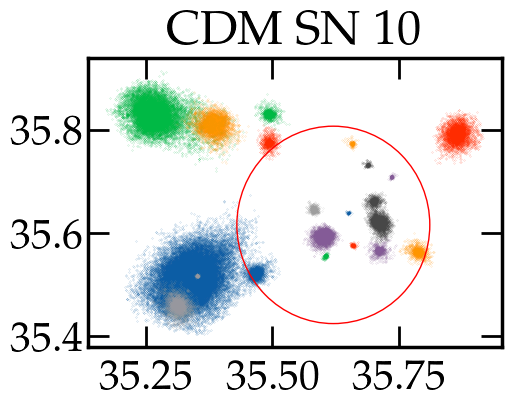

In [21]:
sim_dir_cdm_sn_010 = f'/fred/oz217/aussing/{folder}/cdm/zoom/output/sn_010/'
snap_data_cdm_sn_010, haloinfo_data_cdm_sn_010, z = get_sim_data(sim_dir_cdm_sn_010,i_file)

snap_ids_dm_cdm_sn_010 = snap_data_cdm_sn_010['PartType1']['ParticleIDs']
dm_pos_cdm_sn_010      = snap_data_cdm_sn_010['PartType1']['Coordinates']
# gas_pos_cdm_sn_010     = snap_data_cdm_sn_010['PartType0']['Coordinates']
# star_pos_cdm_sn_010    = snap_data_cdm_sn_010['PartType4']['Coordinates']

subhalo_offset_type_cdm_sn_010 =  np.array(haloinfo_data_cdm_sn_010['Subhalo']['SubhaloOffsetType'], dtype=np.int64)
stel_subhalos_cdm_sn_010 = np.where(subhalo_mass_type_cdm_010[:,4]>0)[0]+1

fig, ax1 = plt.subplots(1,1,figsize=(5,4),dpi=100,layout='constrained')

subhalo_pid_list_cdm_sn_010 = []
for i in stel_subhalos_cdm_sn_010:
# for i in range(1,len(subhalo_mass_type_cdm_010)-1,1):

    sub_id_list = snap_ids_dm_cdm_sn_010[subhalo_offset_type_cdm_sn_010[i,1]:subhalo_offset_type_cdm_sn_010[(i+1),1]]
    subhalo_pid_list_cdm_sn_010.extend(sub_id_list)

    dm_pos_sub_cdm_sn_010 = dm_pos_cdm_sn_010[subhalo_offset_type_cdm_sn_010[i,1]:subhalo_offset_type_cdm_sn_010[(i+1),1]]
    plt.scatter(dm_pos_sub_cdm_sn_010[:,0],dm_pos_sub_cdm_sn_010[:,1], s=0.05,alpha=0.8,marker='.')
    

ax1.add_patch(plt.Circle((halo_pos_cdm_010[0],halo_pos_cdm_010[1]),r_200c_cdm_010, fill=False,color='red',alpha=1))
plt.title('CDM SN 10%')

subhalo_pid_list_cdm_sn_010 = np.array(subhalo_pid_list_cdm_sn_010)
mask_subhalo_pid_cdm_sn_010 = np.isin(snap_ids_dm_cdm_sn_010,subhalo_pid_list_cdm_sn_010)

subhalo_0_pids_cdm_sn_010 = snap_ids_dm_cdm_sn_010[0:subhalo_offset_type_cdm_sn_010[1,1]-1]

group_len_cdm_sn_010 = np.array(haloinfo_data_cdm_sn_010['Group']['GroupLenType'], dtype=np.int64)[0,1]
all_halo_pids_cdm_sn_010 = snap_ids_dm_cdm_sn_010[0:group_len_cdm_sn_010]
# all_halo_pids_cdm_sn_010 = snap_ids_dm_cdm_sn_010[0:subhalo_offset_type_cdm_sn_010[1,0]-1]

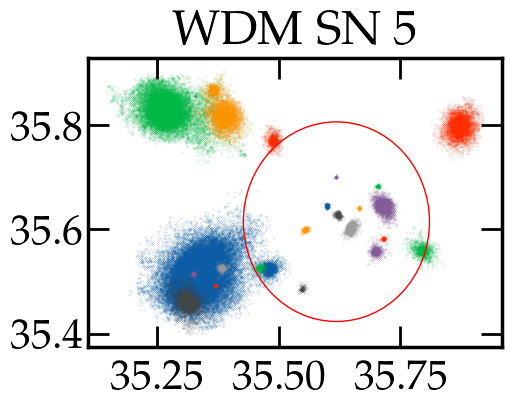

In [22]:
sim_dir_wdm_sn_005 = f'/fred/oz217/aussing/{folder}/wdm_3.5/zoom/output/sn_005/'
snap_data_wdm_sn_005, haloinfo_data_wdm_sn_005, z = get_sim_data(sim_dir_wdm_sn_005,i_file)

snap_ids_dm_wdm_sn_005 = snap_data_wdm_sn_005['PartType1']['ParticleIDs']
dm_pos_wdm_sn_005      = snap_data_wdm_sn_005['PartType1']['Coordinates']
# gas_pos_cdm_sn_010     = snap_data_cdm_sn_010['PartType0']['Coordinates']
# star_pos_cdm_sn_010    = snap_data_cdm_sn_010['PartType4']['Coordinates']

subhalo_offset_type_wdm_sn_005 = np.array(haloinfo_data_wdm_sn_005['Subhalo']['SubhaloOffsetType'], dtype=np.int64)
stel_subhalos_wdm_sn_005 = np.where(subhalo_mass_type_wdm_005[:,4]>0)[0]+1

fig, ax1 = plt.subplots(1,1,figsize=(5,4),dpi=100,layout='constrained')

subhalo_pid_list_wdm_sn_005 = []
for i in stel_subhalos_wdm_sn_005:
# for i in range(1,len(subhalo_mass_type_cdm_010)-1,1):

    sub_id_list = snap_ids_dm_wdm_sn_005[subhalo_offset_type_wdm_sn_005[i,1]:subhalo_offset_type_wdm_sn_005[(i+1),1]]
    subhalo_pid_list_wdm_sn_005.extend(sub_id_list)

    dm_pos_sub_wdm_sn_005 = dm_pos_wdm_sn_005[subhalo_offset_type_wdm_sn_005[i,1]:subhalo_offset_type_wdm_sn_005[(i+1),1]]
    plt.scatter(dm_pos_sub_wdm_sn_005[:,0],dm_pos_sub_wdm_sn_005[:,1], s=0.05,alpha=0.8,marker='.')
    

ax1.add_patch(plt.Circle((halo_pos_wdm_005[0],halo_pos_wdm_005[1]),r_200c_wdm_005, fill=False,color='red',alpha=1))
plt.title('WDM SN 5%')

subhalo_pid_list_wdm_sn_005 = np.array(subhalo_pid_list_wdm_sn_005)
mask_subhalo_pid_wdm_sn_005 = np.isin(snap_ids_dm_wdm_sn_005,subhalo_pid_list_wdm_sn_005)

subhalo_0_pids_wdm_sn_005 = snap_ids_dm_wdm_sn_005[0:subhalo_offset_type_wdm_sn_005[1,1]-1]

group_len_wdm_sn_005 = np.array(haloinfo_data_wdm_sn_005['Group']['GroupLenType'], dtype=np.int64)[0,1]
all_halo_pids_wdm_sn_005 = snap_ids_dm_wdm_sn_005[0:group_len_wdm_sn_005]
# all_halo_pids_cdm_sn_010 = snap_ids_dm_cdm_sn_010[0:subhalo_offset_type_cdm_sn_010[1,0]-1]

 CDM satellite IDS = [  1   2   3   4   5   6   7   8   9  10  11  12  13  15  17  29  30  34
  36  37  48 100]

 CDM subhalo ID = 1
WDM subhalo id = 1, percentage = 88.22%
WDM subhalo id = 6, percentage = 0.01%
WDM subhalo id = 16, percentage = 0.11%
WDM subhalo id = 32, percentage = 0.2%
WDM subhalo id = 37, percentage = 0.0%
WDM subhalo id = 68, percentage = 0.04%
Percentage in CDM Subhalo 0 = 5.9%

Percentage in WDM group = 96.62%
Percentage particles not found = 3.38%

 CDM subhalo ID = 2
WDM subhalo id = 2, percentage = 85.72%
WDM subhalo id = 3, percentage = 1.63%
WDM subhalo id = 10, percentage = 0.0%
Percentage in CDM Subhalo 0 = 4.71%

Percentage in WDM group = 93.21%
Percentage particles not found = 6.79%

 CDM subhalo ID = 3
WDM subhalo id = 2, percentage = 5.02%
WDM subhalo id = 3, percentage = 79.18%
Percentage in CDM Subhalo 0 = 10.86%

Percentage in WDM group = 96.31%
Percentage particles not found = 3.69%

 CDM subhalo ID = 4
WDM subhalo id = 4, percentage = 87.7%
Perc

/tmp/ipykernel_1939320/2392273814.py:15: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, axs = plt.subplots(1,3,figsize=(18,6),dpi=200,layout='constrained',sharey=True,sharex=True)



 CDM subhalo ID = 48
WDM subhalo id = 1, percentage = 40.22%
WDM subhalo id = 32, percentage = 45.11%
Percentage in CDM Subhalo 0 = 8.7%

Percentage in WDM group = 98.91%
Percentage particles not found = 1.09%

 CDM subhalo ID = 100
WDM subhalo id = 53, percentage = 5.41%
Percentage in CDM Subhalo 0 = 90.54%

Percentage in WDM group = 95.95%
Percentage particles not found = 4.05%


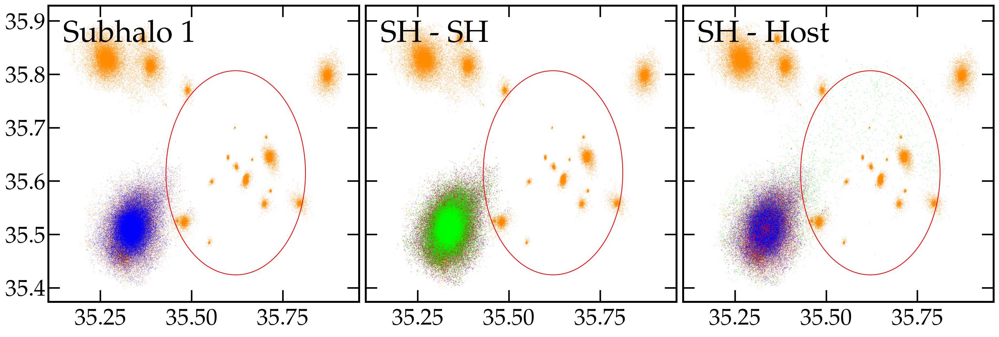

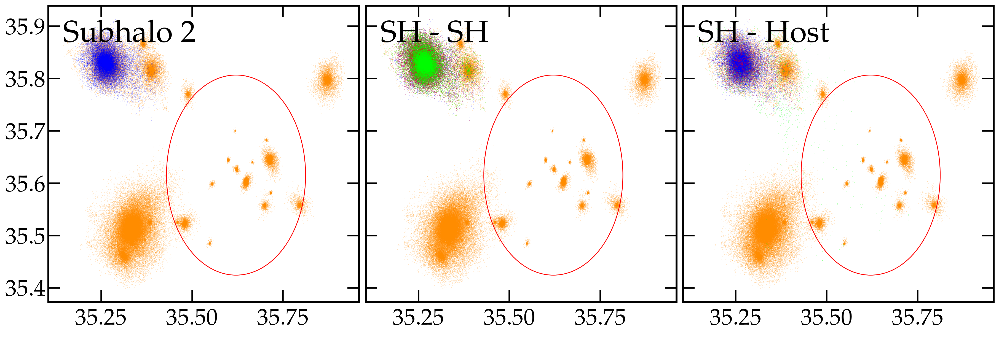

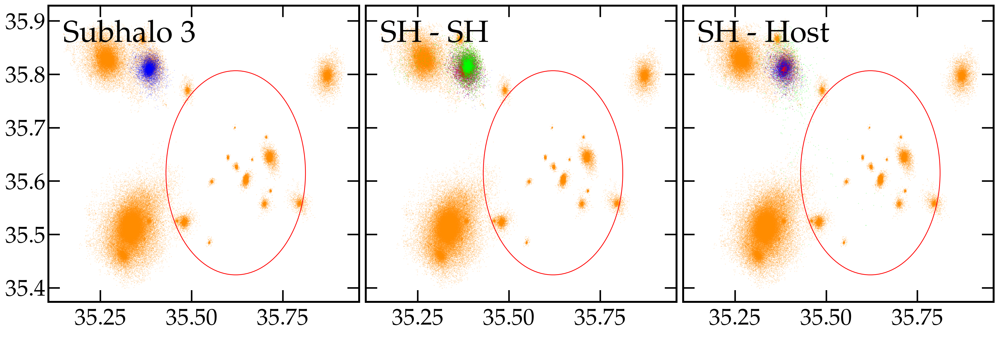

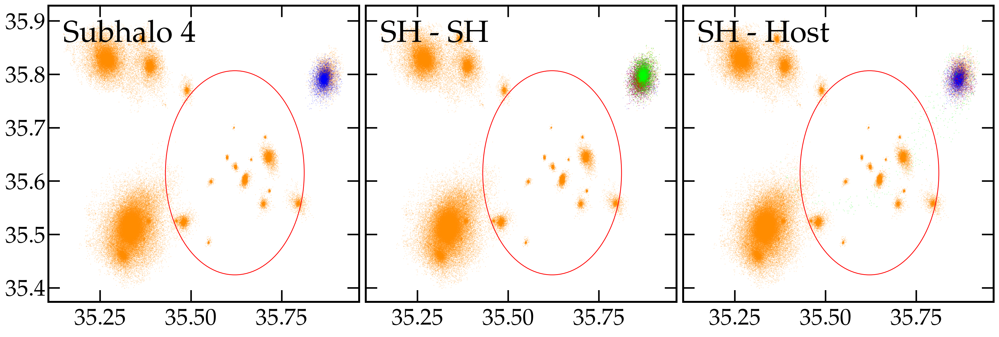

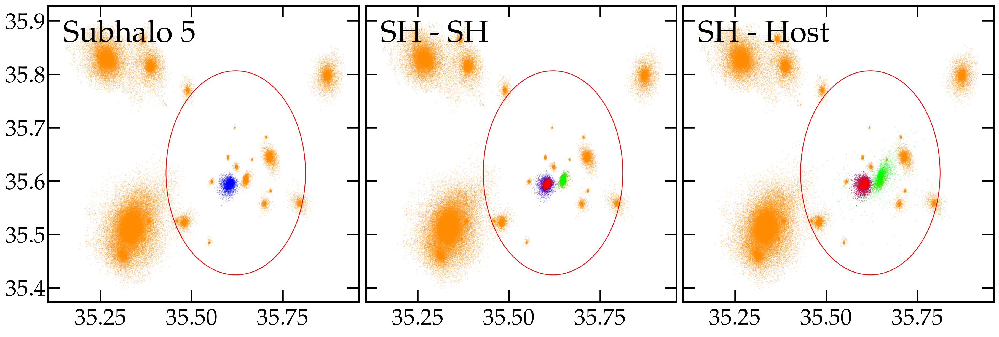

...

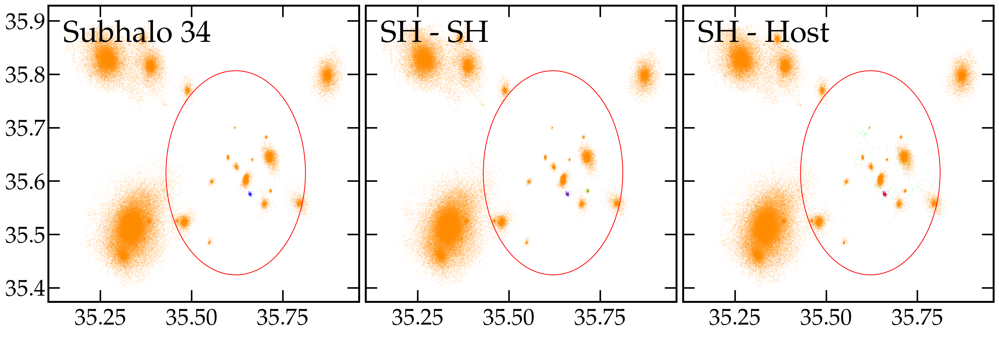

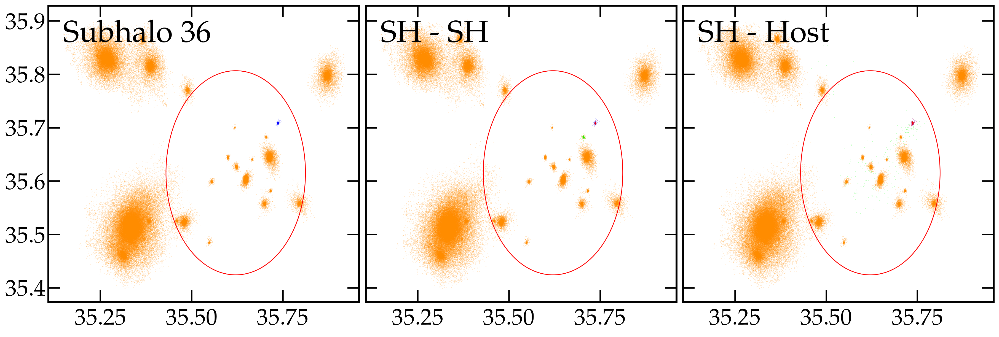

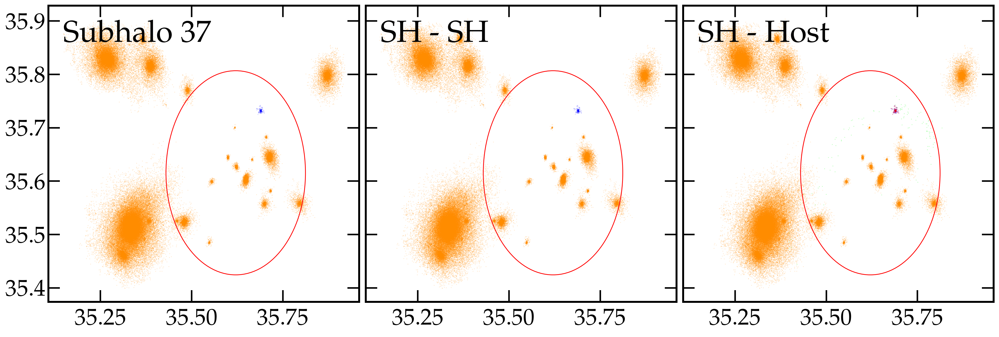

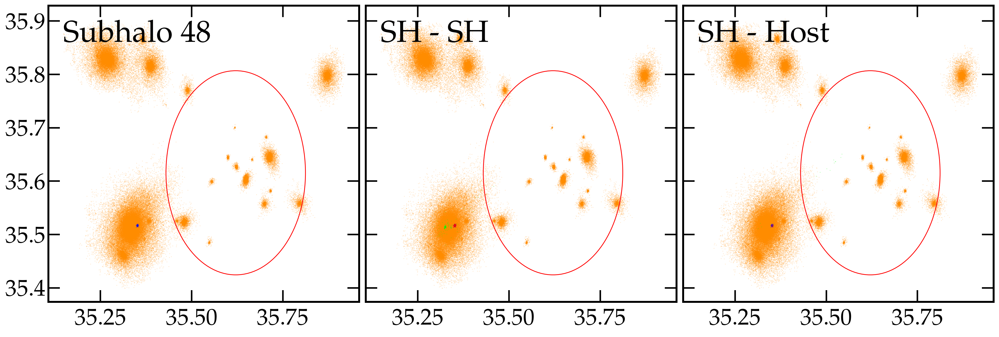

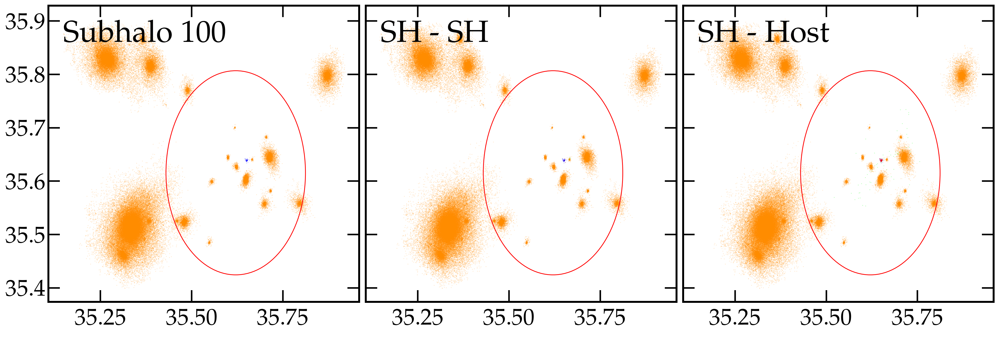

In [23]:
print(f' CDM satellite IDS = {stel_subhalos_cdm_sn_010}')

subhalo_pid_list_cdm_sn_010 = []
# subhalo_pid_list_wdm_sn_005 = np.zeros(1,dtype=np.uint32)
start_index, end_index = len(stel_subhalos_cdm_sn_010)-2,len(stel_subhalos_cdm_sn_010)
# start_index, end_index = 3,6
num_subhaloes = end_index - start_index # len(stel_subhalos_wdm_sn_005)



# all_wdm_sub_percentge_in_cdm_sub_list = []

for n,i in enumerate(stel_subhalos_cdm_sn_010):
# for i in range(1,len(subhalo_mass_type_wdm_005)-1,1):
    fig, axs = plt.subplots(1,3,figsize=(18,6),dpi=200,layout='constrained',sharey=True,sharex=True)
    print(f'\n CDM subhalo ID = {i}')

    axs[0].scatter(dm_pos_wdm_sn_005[:,0][mask_subhalo_pid_wdm_sn_005],dm_pos_wdm_sn_005[:,1][mask_subhalo_pid_wdm_sn_005], s=0.05,alpha=0.8,linewidths=0.6,marker='.',color='darkorange')
    axs[1].scatter(dm_pos_wdm_sn_005[:,0][mask_subhalo_pid_wdm_sn_005],dm_pos_wdm_sn_005[:,1][mask_subhalo_pid_wdm_sn_005], s=0.05,alpha=0.8,linewidths=0.6,marker='.',color='darkorange')
    axs[2].scatter(dm_pos_wdm_sn_005[:,0][mask_subhalo_pid_wdm_sn_005],dm_pos_wdm_sn_005[:,1][mask_subhalo_pid_wdm_sn_005], s=0.05,alpha=0.8,linewidths=0.6,marker='.',color='darkorange')
    
    subhalo_pid_list_single_sub = snap_ids_dm_cdm_sn_010[subhalo_offset_type_cdm_sn_010[i,1]:subhalo_offset_type_cdm_sn_010[(i+1),1]]
    subhalo_pid_list_cdm_sn_010.extend(subhalo_pid_list_single_sub[:,])
    # print(len(subhalo_pid_list_wdm_sn_005))
    
    
    dm_pos_sub_cdm_sn_010_single_sub = dm_pos_cdm_sn_010[subhalo_offset_type_cdm_sn_010[i,1]:subhalo_offset_type_cdm_sn_010[(i+1),1]]
    axs[0].scatter(dm_pos_sub_cdm_sn_010_single_sub[:,0],dm_pos_sub_cdm_sn_010_single_sub[:,1], s=0.05,alpha=0.8,linewidths=0.6,marker='.',color='blue')
    axs[1].scatter(dm_pos_sub_cdm_sn_010_single_sub[:,0],dm_pos_sub_cdm_sn_010_single_sub[:,1], s=0.05,alpha=0.8,linewidths=0.6,marker='.',color='blue')
    axs[2].scatter(dm_pos_sub_cdm_sn_010_single_sub[:,0],dm_pos_sub_cdm_sn_010_single_sub[:,1], s=0.05,alpha=0.8,linewidths=0.6,marker='.',color='blue')
    

    mask_cdm_sub_part_in_wdm_subs_single_sub = np.isin(subhalo_pid_list_single_sub,subhalo_pid_list_wdm_sn_005)
    pids_cdm_sub_part_in_wdm_subs_single_sub = np.array(subhalo_pid_list_single_sub)[mask_cdm_sub_part_in_wdm_subs_single_sub]

    mask_all_cdm_part_in_wdm_subs = np.isin(snap_ids_dm_cdm_sn_010,pids_cdm_sub_part_in_wdm_subs_single_sub)
    axs[1].scatter(dm_pos_cdm_sn_010[:,0][mask_all_cdm_part_in_wdm_subs],dm_pos_cdm_sn_010[:,1][mask_all_cdm_part_in_wdm_subs], s=0.1,alpha=0.6,linewidths=0.8,marker='.',color='red')
    

    for x in stel_subhalos_wdm_sn_005:
            sub_id_list_wdm_check = snap_ids_dm_wdm_sn_005[subhalo_offset_type_wdm_sn_005[x,1]:subhalo_offset_type_wdm_sn_005[(x+1),1]]
            mask_cdm_sub_in_wdm_sub = np.isin(subhalo_pid_list_single_sub,sub_id_list_wdm_check)

            if np.sum(mask_cdm_sub_in_wdm_sub) > 0:
                # print(np.sum(np.isin(subhalo_pid_list_single_sub,sub_id_list_cdm_check)))
                percentage_cdm_subs = np.round(np.sum(mask_cdm_sub_in_wdm_sub)/len(subhalo_pid_list_single_sub)*100,2)
                print(f'WDM subhalo id = {x}, percentage = {percentage_cdm_subs}%')

                wdm_parts_in_cdm_sub = np.isin(sub_id_list_wdm_check,subhalo_pid_list_single_sub)
                wdm_pos_mask = np.isin(snap_ids_dm_wdm_sn_005,sub_id_list_wdm_check[wdm_parts_in_cdm_sub])                
                axs[1].scatter(dm_pos_wdm_sn_005[:,0][wdm_pos_mask],dm_pos_wdm_sn_005[:,1][wdm_pos_mask], s=0.1,alpha=0.6,linewidths=0.8,marker='.',color='lime')
                
            else:
                percentage_wdm_subs = 0
                # print(f'cdm subhalo id = {x}, no particles shared')
    
    mask_cdm_subs_in_wdm_sub_0 =  np.isin(subhalo_pid_list_single_sub,subhalo_0_pids_wdm_sn_005)
    if np.sum(mask_cdm_subs_in_wdm_sub_0)>0 :
        pid_list_cdm_subs_in_wdm_sub_0 = subhalo_pid_list_single_sub[mask_cdm_subs_in_wdm_sub_0]
        wdm_sub_0_in_cdm_sub_mask = np.isin(snap_ids_dm_wdm_sn_005,pid_list_cdm_subs_in_wdm_sub_0)

        cdm_in_wdm_sub_0_mask = np.isin(snap_ids_dm_cdm_sn_010,pid_list_cdm_subs_in_wdm_sub_0)
        axs[2].scatter(dm_pos_wdm_sn_005[:,0][wdm_sub_0_in_cdm_sub_mask],dm_pos_wdm_sn_005[:,1][wdm_sub_0_in_cdm_sub_mask],s=0.1,alpha=0.6,linewidths=0.8,marker='.',color='lime')
        axs[2].scatter(dm_pos_cdm_sn_010[:,0][cdm_in_wdm_sub_0_mask],    dm_pos_cdm_sn_010[:,1][cdm_in_wdm_sub_0_mask],    s=0.1,alpha=0.6,linewidths=0.8,marker='.',color='red')
        
        percentage_cdm_sub_0 = np.round(np.sum(mask_cdm_subs_in_wdm_sub_0)/len(subhalo_pid_list_single_sub)*100,2)
        print(f'Percentage in CDM Subhalo 0 = {percentage_cdm_sub_0}%')


    mask_cdm_sub_in_wdm_group = np.isin(subhalo_pid_list_single_sub,all_halo_pids_wdm_sn_005)
    if np.sum(mask_cdm_sub_in_wdm_group)>0 :
        percentage_wdm_group = np.round(np.sum(mask_cdm_sub_in_wdm_group)/len(subhalo_pid_list_single_sub)*100,2)
        print(f'\nPercentage in WDM group = {percentage_wdm_group}%')
        print(f'Percentage particles not found = {np.round(100-percentage_wdm_group,2)}%')
    else:
        print('\nNo particles in CDM group')

    

    axs[0].add_patch(plt.Circle((halo_pos_cdm_010[0],halo_pos_cdm_010[1]),r_200c_cdm_010, fill=False,color='red',alpha=1))
    axs[1].add_patch(plt.Circle((halo_pos_cdm_010[0],halo_pos_cdm_010[1]),r_200c_cdm_010, fill=False,color='red',alpha=1))
    axs[2].add_patch(plt.Circle((halo_pos_cdm_010[0],halo_pos_cdm_010[1]),r_200c_cdm_010, fill=False,color='red',alpha=1))
    
    axs[0].text(0.05,0.95, f'Subhalo {i}',ha='left', va='top',transform=axs[0].transAxes,fontsize=40.0,weight='bold',color='k')
    axs[1].text(0.05,0.95, 'SH - SH',     ha='left', va='top',transform=axs[1].transAxes,fontsize=40.0,weight='bold',color='k')
    axs[2].text(0.05,0.95, 'SH - Host',   ha='left', va='top',transform=axs[2].transAxes,fontsize=40.0,weight='bold',color='k')

    # axs[0].set_title(f'CDM subhalo {i}')
    # axs[1].set_title(f'Particles in WDM Subhalo ')
    # axs[2].set_title(f'Particles in WDM Host')
    plt.savefig(f'./proj_2/{folder}/cdm_sub_in_wdm_{i}.png')
# print('./proj_2/cdm_subs_in_wdm_last.png')
# subhalo_pid_list_wdm_sn_005 = np.array(subhalo_pid_list_wdm_sn_005)
# mask_subhalo_pid_wdm_sn_005 = np.isin(snap_ids_dm_wdm_sn_005,subhalo_pid_list_wdm_sn_005)


In [24]:
subhalo_pid_list_cdm_sn_010 = []
stellar_mass_cdm_010 = subhalo_mass_type_cdm_010[:,4]#*UNITMASS/LITTLEH
# start_index, end_index = len(stel_subhalos_cdm_sn_010)-3,len(stel_subhalos_cdm_sn_010)
start_index, end_index = 0,len(stel_subhalos_cdm_sn_010)
num_subhaloes = end_index - start_index # len(stel_subhalos_wdm_sn_005)
all_cdm_sub_percentge_in_wdm_sub_list = []
satellite_particle_len = []

for n,i in enumerate(stel_subhalos_cdm_sn_010[start_index:end_index]):
    print(f'\nCDM subhalo ID = {i}, stellar mass = {(stellar_mass_cdm_010[i-1]*1e10):.2e} h^-1 Msun')
    
    subhalo_pid_list_single_sub = snap_ids_dm_cdm_sn_010[subhalo_offset_type_cdm_sn_010[i,1]:subhalo_offset_type_cdm_sn_010[(i+1),1]]
    subhalo_pid_list_cdm_sn_010.extend(subhalo_pid_list_single_sub[:,])
    satellite_particle_len.append(len(subhalo_pid_list_single_sub))

    dm_pos_sub_cdm_sn_010_single_sub = dm_pos_cdm_sn_010[subhalo_offset_type_cdm_sn_010[i,1]:subhalo_offset_type_cdm_sn_010[(i+1),1]]
    
    single_cdm_sub_percentge_in_wdm_sub_list = []
    # mask_wdm_sub_part_in_cdm_subs = np.isin(subhalo_pid_list_wdm_sn_005,subhalo_pid_list_cdm_sn_010)
    # pids_wdm_sub_part_in_cdm_subs = np.array(subhalo_pid_list_wdm_sn_005)[mask_wdm_sub_part_in_cdm_subs]
    
    cdm_sub_in_wdm_group = np.isin(subhalo_pid_list_single_sub,all_halo_pids_wdm_sn_005)
    percentage_wdm_group = np.round(np.sum(cdm_sub_in_wdm_group)/len(subhalo_pid_list_single_sub)*100,2)
    single_cdm_sub_percentge_in_wdm_sub_list.append(percentage_wdm_group)
    
    if np.sum(cdm_sub_in_wdm_group)>0 :        
        print(f'Percentage in WDM group = {percentage_wdm_group}%')
        # print(f'Percentage particles not found = {np.round(100-percentage_cdm_group,2)}%\n')
    else:
        print('No particles in CDM group')

    cdm_subs_pid_in_wdm_sub_0 =  np.isin(subhalo_pid_list_single_sub,subhalo_0_pids_wdm_sn_005)
    percentage_wdm_sub_0 = np.round(np.sum(cdm_subs_pid_in_wdm_sub_0)/len(subhalo_pid_list_single_sub)*100,2)
    single_cdm_sub_percentge_in_wdm_sub_list.append(percentage_wdm_sub_0)

    if np.sum(cdm_subs_pid_in_wdm_sub_0)>0 :
        print(f'Percentage in WDM Subhalo 0 = {percentage_wdm_sub_0}%')

    for x in stel_subhalos_wdm_sn_005:
            sub_id_list_wdm_check = snap_ids_dm_wdm_sn_005[subhalo_offset_type_wdm_sn_005[x,1]:subhalo_offset_type_wdm_sn_005[(x+1),1]]
            mask_cdm_sub_in_wdm_sub = np.isin(subhalo_pid_list_single_sub,sub_id_list_wdm_check)
            percentage_wdm_subs = np.round(np.sum(mask_cdm_sub_in_wdm_sub)/len(subhalo_pid_list_single_sub)*100,2)
            single_cdm_sub_percentge_in_wdm_sub_list.append(percentage_wdm_subs)
            if np.sum(mask_cdm_sub_in_wdm_sub) > 0:                                
                print(f'wdm subhalo id = {x}, percentage = {percentage_wdm_subs}%')
                # wdm_parts_in_cdm_sub = np.isin(sub_id_list_wdm_check,subhalo_pid_list_single_sub)
                # wdm_pos_mask = np.isin(snap_ids_dm_cdm_sn_010,sub_id_list_wdm_check[wdm_parts_in_cdm_sub])                

    all_cdm_sub_percentge_in_wdm_sub_list.append(single_cdm_sub_percentge_in_wdm_sub_list)
    
    # mask_wdm_sub_part_in_cdm_subs_single_sub = np.isin(subhalo_pid_list_single_sub,subhalo_pid_list_cdm_sn_010)
    # pids_wdm_sub_part_in_cdm_subs_single_sub = np.array(subhalo_pid_list_single_sub)[mask_wdm_sub_part_in_cdm_subs_single_sub]

    # mask_all_wdm_part_in_cdm = np.isin(snap_ids_dm_wdm_sn_005,pids_wdm_sub_part_in_cdm_subs_single_sub)

all_wdm_sub_percentge_in_cdm_sub_list = np.array(all_cdm_sub_percentge_in_wdm_sub_list)
satellite_particle_len = np.array(satellite_particle_len)

# subhalo_pid_list_wdm_sn_005 = np.array(subhalo_pid_list_wdm_sn_005)
# mask_subhalo_pid_wdm_sn_005 = np.isin(snap_ids_dm_wdm_sn_005,subhalo_pid_list_wdm_sn_005)



CDM subhalo ID = 1, stellar mass = 9.93e+08 h^-1 Msun
Percentage in WDM group = 96.62%
Percentage in WDM Subhalo 0 = 5.9%
wdm subhalo id = 1, percentage = 88.22%
wdm subhalo id = 6, percentage = 0.01%
wdm subhalo id = 16, percentage = 0.11%
wdm subhalo id = 32, percentage = 0.2%
wdm subhalo id = 37, percentage = 0.0%
wdm subhalo id = 68, percentage = 0.04%

CDM subhalo ID = 2, stellar mass = 2.09e+08 h^-1 Msun
Percentage in WDM group = 93.21%
Percentage in WDM Subhalo 0 = 4.71%
wdm subhalo id = 2, percentage = 85.72%
wdm subhalo id = 3, percentage = 1.63%
wdm subhalo id = 10, percentage = 0.0%

CDM subhalo ID = 3, stellar mass = 2.20e+07 h^-1 Msun
Percentage in WDM group = 96.31%
Percentage in WDM Subhalo 0 = 10.86%
wdm subhalo id = 2, percentage = 5.02%
wdm subhalo id = 3, percentage = 79.18%

CDM subhalo ID = 4, stellar mass = 3.51e+07 h^-1 Msun
Percentage in WDM group = 94.94%
Percentage in WDM Subhalo 0 = 6.76%
wdm subhalo id = 4, percentage = 87.7%

CDM subhalo ID = 5, stellar ma

Percentage in WDM Subhalo 0 = 5.22%
wdm subhalo id = 9, percentage = 92.17%

CDM subhalo ID = 11, stellar mass = 3.99e+06 h^-1 Msun
Percentage in WDM group = 97.98%
Percentage in WDM Subhalo 0 = 26.2%
wdm subhalo id = 11, percentage = 61.75%

CDM subhalo ID = 12, stellar mass = 9.18e+06 h^-1 Msun
Percentage in WDM group = 78.67%
Percentage in WDM Subhalo 0 = 19.48%
wdm subhalo id = 1, percentage = 0.37%
wdm subhalo id = 12, percentage = 58.82%

CDM subhalo ID = 13, stellar mass = 3.19e+06 h^-1 Msun
Percentage in WDM group = 84.1%
Percentage in WDM Subhalo 0 = 48.37%
wdm subhalo id = 22, percentage = 33.97%

CDM subhalo ID = 15, stellar mass = 1.20e+06 h^-1 Msun
Percentage in WDM group = 99.36%
Percentage in WDM Subhalo 0 = 33.19%
wdm subhalo id = 7, percentage = 0.11%
wdm subhalo id = 15, percentage = 65.52%

CDM subhalo ID = 17, stellar mass = 3.99e+05 h^-1 Msun
Percentage in WDM group = 90.55%
Percentage in WDM Subhalo 0 = 4.99%
wdm subhalo id = 1, percentage = 18.35%
wdm subhalo id 

In [25]:
all_cdm_sub_percentge_in_wdm_sub_list = np.array(all_cdm_sub_percentge_in_wdm_sub_list)
print(stel_subhalos_wdm_sn_005)
# print(np.sum(all_wdm_sub_percentge_in_cdm_sub_list[:,2:],axis=1))
# print(len(all_wdm_sub_percentge_in_cdm_sub_list[:,0]))
print('ID & Sub Len & % found & % not found & % found in Sub 0 & % found in sats')
with open(f'./proj_2/{folder}/summary_cdm_in_wdm.txt', 'w+') as f:
    f.write('ID & Sub Len & % found & % not found & % found in Sub 0 & % found in sats\n')
    for i in range(len(all_wdm_sub_percentge_in_cdm_sub_list[:,0])):
        print(stel_subhalos_cdm_sn_010[i], ' & ' , satellite_particle_len[i], '& ' ,all_cdm_sub_percentge_in_wdm_sub_list[i,0] , ' & ' , np.round(100-all_cdm_sub_percentge_in_wdm_sub_list[i,0],2) , ' & ' , all_cdm_sub_percentge_in_wdm_sub_list[i,1], ' & ' , np.sum(all_cdm_sub_percentge_in_wdm_sub_list[i,2:]), '\\','\\')
        f.write(f'{stel_subhalos_cdm_sn_010[i]} & {satellite_particle_len[i]} & {all_cdm_sub_percentge_in_wdm_sub_list[i,0]} & {np.round(100-all_cdm_sub_percentge_in_wdm_sub_list[i,0],2)}  &  {all_cdm_sub_percentge_in_wdm_sub_list[i,1]} & {np.sum(all_cdm_sub_percentge_in_wdm_sub_list[i,2:])} \ \ \n')
    # print( )

[ 1  2  3  4  5  6  7  8  9 10 11 12 15 16 21 22 25 29 32 33 36 37 40 53
 68 73]
ID & Sub Len & % found & % not found & % found in Sub 0 & % found in sats
1  &  65779 &  96.62  &  3.38  &  5.9  &  88.58000000000001 \ \
2  &  26262 &  93.21  &  6.79  &  4.71  &  87.35 \ \
3  &  8186 &  96.31  &  3.69  &  10.86  &  84.2 \ \
4  &  6465 &  94.94  &  5.06  &  6.76  &  87.7 \ \
5  &  7404 &  98.49  &  1.51  &  46.97  &  44.519999999999996 \ \
6  &  5253 &  99.35  &  0.65  &  17.59  &  80.34 \ \
7  &  4306 &  97.63  &  2.37  &  4.62  &  87.04 \ \
8  &  3615 &  84.37  &  15.63  &  24.23  &  59.64 \ \
9  &  1704 &  85.04  &  14.96  &  9.92  &  75.12 \ \
10  &  1494 &  97.46  &  2.54  &  5.22  &  92.17 \ \
11  &  1485 &  97.98  &  2.02  &  26.2  &  61.75 \ \
12  &  1355 &  78.67  &  21.33  &  19.48  &  59.19 \ \
13  &  1195 &  84.1  &  15.9  &  48.37  &  33.97 \ \
15  &  931 &  99.36  &  0.64  &  33.19  &  65.63 \ \
17  &  741 &  90.55  &  9.45  &  4.99  &  81.50999999999999 \ \
29  &  340 &  97

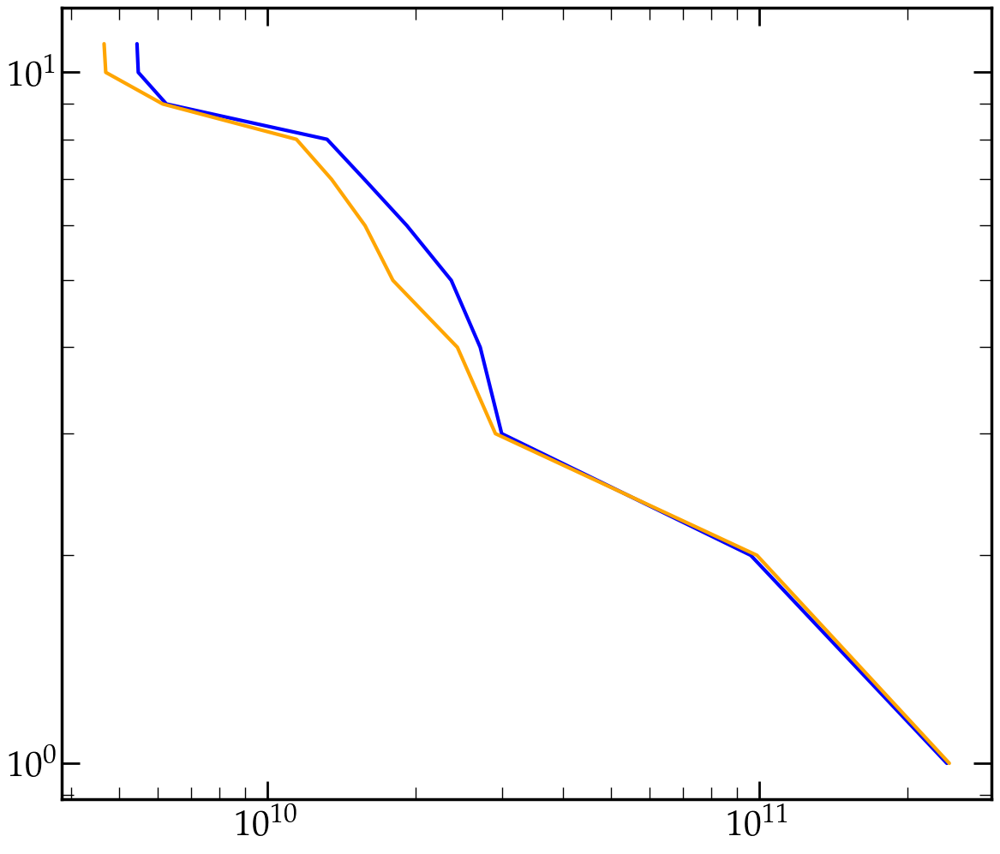

In [26]:
stellar_mass_cdm_010         = subhalo_mass_type_cdm_010[:,1]*UNITMASS/LITTLEH
stellar_mass_ordered_cdm_010 = np.sort(stellar_mass_cdm_010[stellar_mass_cdm_010>0])[::-1]
stellar_mass_ordered_cdm_010 = stellar_mass_ordered_cdm_010[0:11]
stellar_mass_sum_cdm_010     = np.cumsum(np.ones(stellar_mass_ordered_cdm_010.shape))

stellar_mass_wdm_005        = subhalo_mass_type_wdm_005[:,1]*UNITMASS/LITTLEH
stellar_mass_wdm_005_sorted = np.sort(stellar_mass_wdm_005[stellar_mass_wdm_005>0])[::-1]
stellar_mass_wdm_005_sorted = stellar_mass_wdm_005_sorted[0:11]
stellar_mass_sum_wdm_005    = np.cumsum(np.ones(stellar_mass_wdm_005_sorted.shape))


plt.plot(stellar_mass_ordered_cdm_010,stellar_mass_sum_cdm_010,c='b')
plt.plot(stellar_mass_wdm_005_sorted,stellar_mass_sum_wdm_005,c='orange')

# plt.ylim
plt.xscale('log')
plt.yscale('log')


